# Multilayer Perceptron in PyTorch

### Goal
Learn the basics of PyTorch (PT) by working on an artificial classification problem.

### Plan
We will create a set of synthetic data that we will use as an example problem.
Then we will create a MLP model and learn its parameters from the data. Finally we will visualize the different learning measures and the parameters of the model.


In [15]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

from colorama import Fore, Back, Style
from termcolor import cprint

### Data generation

In this part, we will generate a data set of 1000 points of 2 dimensions $(x_0, x_1)$ with their coordinates between 0 et 1 $x_0, x_1 \in [-1, 1)$ which is not linearly separable.



In [2]:
points = np.random.uniform(-1, 1, size=(1000, 2))

Assign to each point a binary class $y$ (0 ou 1) following the condition:
$$
y = \begin{cases}
1 &\text{if $x_0 > -0.4$ et $x_1 > -0.3$}\\
0 &\text{else}
\end{cases}
$$


In [3]:
y = np.where((points[:, 0] > -0.4) & (points[:, 1] > -0.3), 1, 0)

Create a matrix of data `data` with shape `(1000, 3)` with a point per row, the two first columns contain the points coordinates $(x_0, x_1)$ the last column contains the class $y$.


In [4]:
data = np.column_stack((points, y))
data.shape

(1000, 3)

Split the data into 3 sets (on matrix for each): 800 points for `train`, 100 points for `valid` and 100 for `test`

In [5]:

train = data[:800, :]
valid = data[800:900, :]
test = data[900:, :]

Visualise the data

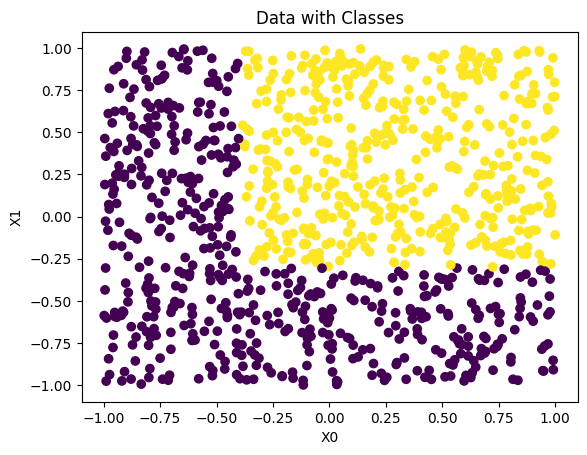

In [6]:
plt.scatter(data[:,0],data[:,1], c = y)
plt.title('Data with Classes')
plt.xlabel('X0')
plt.ylabel('X1')
plt.show()


In [20]:
# Verification des dimensions des donnees
assert data.shape == (1000, 3)

# Verification des division desd donnees
assert train.shape == (800, 3)
assert valid.shape == (100, 3)
assert test.shape == (100, 3)

for dataset in [train, valid, test]:
    # Verification des classes
    assert (dataset[dataset[:,-1]==1,0] > -0.4).all()
    assert (dataset[dataset[:,-1]==1,1] > -0.3).all()
    assert ((dataset[dataset[:,-1]==0,0] <= -0.4) | (dataset[dataset[:,-1]==0,1] <= -0.3)).all()

cprint('Everything looks good!', 'black', 'on_white', attrs=['bold'])


Everything looks good!


### Creating the model
In this part, we will create, with PyTorch, a model to predict the class $y$ of a point using only its coordinates $(x_0, x_1)$.

The model we will create to classify the data is a Multilayer Perceptron with a single hidden layer with 2 units:

\begin{align}
h_1 &= \sigma(x W_1 + b_1) \\
\hat{y} &= \sigma(h_1 W_2 + b_2) \\
& \textrm{ avec } & \\
\sigma(t) &= \frac{1}{1+e^{-t}}
\end{align}

$\hat{y}$ will the model's estimation for the class of the point.


$W_1$: Weight matrix for the connections between the input layer and the hidden layer.
$b_1$: Bias vector for the hidden layer.
$W_2$: Weight matrix for the connections between the hidden layer and the output layer.
$b_2$: Bias vector for the output layer.

*Implementation en PyTorch*

First we will do a low level implementation where we will only use the auto-differentiation feature (which allows to automatically compute gradients) of PyTorch. Everything else will be using the low-level API which is similar to numpy's.

One major difference between numpy and PyTorch's low-level API is the possibility to compute gradients of some variables. For doing so we will have to set the flag `requires_grad=True` for these variables. This can be done during the construction of the `array` (or rather `tensor` in PyTorch).

For example $W_1$ is a parameter of the model and we are interested in the gradient of the loss with respect to this symbol. So at initialization time we will add the keyword argument `requires_grad=True`.


* $x$: Input vector representing the coordinates of a point. In this case, it is a 2-dimensional vector, so $x \in \mathbb{R}^2$.
* $y$: Binary class label (0 or 1) assigned to a point based on the conditions. It is a scalar.
* $W_1$: Weight matrix connecting the input layer to the hidden layer. If the hidden layer has 2 units, and $x$ is 2-dimensional, then $W_1 \in \mathbb{R}^{2 \times 2}$.
* $b_1$: Bias vector for the hidden layer. If the hidden layer has 2 units, then $b_1 \in \mathbb{R}^2$.
* $W_2$: Weight matrix connecting the hidden layer to the output layer. If there's one output unit, then $W_2 \in \mathbb{R}^{2 \times 1}$.
* $b_2$: Bias scalar for the output layer.

Initialize the weights $W$ with `torch.randn` and the bias $b$ with `torch.zero` explain why we do so.

In [9]:

# Create the model
def init_mlp(n_input, n_hidden, n_output):
    # Initialize weights with random values
    W1 = torch.randn(n_input, n_hidden, requires_grad=True)
    W2 = torch.randn(n_hidden, n_output, requires_grad=True)

    # Initialize biases with zeros
    b1 = torch.zeros(n_hidden, requires_grad=True)
    b2 = torch.zeros(n_output, requires_grad=True)

    return W1, b1, W2, b2

params = init_mlp(2, 2, 1)

In [24]:
cprint(f'w1 = {params[0]}', 'black', 'on_white', attrs=['bold'])
cprint(f'b1 = {params[1]}', 'black', 'on_white', attrs=['bold'])
cprint(f'w2 = {params[2]}', 'black', 'on_white', attrs=['bold'])
cprint(f'b2 = {params[3]}', 'black', 'on_white', attrs=['bold'])


w1 = tensor([[ 0.2776,  0.3050],
        [-1.8192,  0.6401]], requires_grad=True)
b1 = tensor([0., 0.], requires_grad=True)
w2 = tensor([[2.1870],
        [0.5776]], requires_grad=True)
b2 = tensor([0.], requires_grad=True)


What is the desired response for the following points?
$$(-0.9, 0.5), (-0.7, -0.5), (0.3, -0.15), (0.1, 0.15)$$

(-0.9, 0.5): y = 0 \
(-0.7, -0.): y = 0 \
(0.3, -15):  y = 1 \
(0.1,0.15):  y = 1

### Exercise 9
Execute the model on the previous points and print $\hat{y}$. The matrix multiplication in PyTorch is done with `@`.


In [25]:
# Create a function sigmoid(t) that computes the sigmoid function on t
def sigmoid(t):
    return 1./(1. + torch.exp(-t))


# Create a function mlp(x, params) that computes the MLP outputs given the inputs x
def mlp(x, parms):
    W1, b1, W2, b2 = params
    h1 = sigmoid(x@W1 + b1)
    y_estime =  sigmoid(h1@W2 + b2).squeeze(1)  # squeeze change the shape from ([batch_size],1) to [batch_size]
    return y_estime

# Create a tensor containing the previous points
points_ex = torch.tensor([[-0.9, 0.5], [-0.7, -0.5], [0.3, -0.15], [0.1, 0.15]])
print(points_ex)

with torch.no_grad():
    y_estime = mlp(points_ex, params)
    cprint(y_estime, 'black', 'on_white', attrs=['bold'])


tensor([[-0.9000,  0.5000],
        [-0.7000, -0.5000],
        [ 0.3000, -0.1500],
        [ 0.1000,  0.1500]])
tensor([0.6937, 0.8432, 0.8284, 0.7803])


We can observe that the results are not good, because they are far from the expected result.

If we want to compute on our test data the performance of the model we will define an accuracy function, which takes a decision for each data based on $\hat{y}$ and compares it to $y$.

$$
\text{accuracy} = \frac{1}{N} \sum_i^N (1 - abs(y - round(\hat{y}_i)))
$$

The accuracy represents the rate of correctly classified points. It will be $1$ if all points are correctly classified, $0$ if all are misclassified and $0.5$ if half are well classified.


Implement the accuracy 

In [12]:
def accuracy(estimated, reference):
    ### BEGIN SOLUTION
    acc = torch.mean(1 - torch.abs(estimated - torch.round(reference)))
    return acc

Write a `score_model` function that evaluates the performance (accuracy) of the model on a given data set. Print the result.

In [27]:
def score_model(params, data):
    x = torch.tensor(data[:, :2], dtype=torch.float32)
    reference = torch.tensor(data[:, 2], dtype=torch.float32)

    with torch.no_grad():
        y_estime= mlp(x, params)
        acc = accuracy(y_estime, reference)
    return acc


acc = score_model(params, train).item()
cprint(f'score train: {acc:.2%}', 'black', 'on_white', attrs=['bold'])

score train: 46.27%


### Exercise 12
Do the same with `valid` and `test`


In [28]:
cprint(f'score valid: {score_model(params, valid):.2%}', 'black', 'on_white', attrs=['bold'])
cprint(f'score test: {score_model(params, test):.2%}', 'black', 'on_white', attrs=['bold'])


score valid: 44.41%
score test: 41.11%


Explain the results.

* The results you're seeing are expected because, we haven't trained the model yet. The initial parameters of the model were randomly initialized, and without training, the model hasn't learned meaningful patterns from the data. Therefore, its predictions are essentially random, leading to low accuracy on both the validation and test sets.\

## Training the model

To find the best parameters for our model we will enter it with the training data. For this we will define a cost function to optimize.

As we are trying to solve a binary classification task, we will use the crossentropy cost function:

$$
L = \sum -y \log(\hat{y}) - (1-y) \log(1-\hat{y})
$$



Implement the cost function in PyTorch.


In [29]:
def bce(est, ref):
    L = torch.sum(-ref*torch.log(est) - (1-ref)*torch.log(1-est))
    return L


To train our model by means of Gradient Descent (GD) we will iteratively update with small increments our parameters:

\begin{align}
W_1^n &= W_1^{n-1} - \eta \frac{\delta L}{\delta W_1} \\
b_1^n &= b_1^{n-1} - \eta \frac{\delta L}{\delta b_1} \\
W_2^n &= W_2^{n-1} - \eta \frac{\delta L}{\delta W_2} \\
b_2^n &= b_2^{n-1} - \eta \frac{\delta L}{\delta b_2}
\end{align}

Where $\eta$ is our learning rate.

We need to calculate the gradients:
$$
\frac{\delta L}{\delta W_1}, \frac{\delta L}{\delta b_1}, \frac{\delta L}{\delta W_2}, \frac{\delta L}{\delta b_2}
$$

For the gradients of the cost function with respect to the parameters, we could calculate them by hand. But we are lazy. So we will use PyTorch `error.backward()` will do this for us in an optimized way using Dynamic Programming (DP) and populate the tensors with the gradients.

Finally we will run a training of 10 `epochs` with a `batch_size=100`.
For this we will do the following steps:
1. Calculate the number of iterations (`n_iterations`) per epoch (remember that an iteration is an update of the parameters and an epoch is a competing use of all our training data)
2. Create a session
3. Initialize the variables
4. For each epoch (`for epoch in range(n_epochs):`)
    1. Randomly reorder the `train` data (use `torch.randperm()`)
    2. Every 10 epochs evaluate and print the model score on the training data
    3. For each iteration (`for iteration in range(n_iterations):`)
        1. Select a block of `batch_size` examples
        2. *Zero the gradients*
        3. Run the forward pass on the model (`mlp()`)
        4. Compute the loss (`bce()`)
        5. Compute the gradients
        6. *Update the parameters doing gradient descent*

**Note:** Remember that PyTorch keeps track of all the operations you make with tensors to build the DAG graph. In some cases we want to avoid that, such as when setting the gradients to zero or performing the gradient descent update of the parameters. In those cases we may encapsulate the operations inside a `with torch.no_grad():` context clause. Furthermore the `grad` attribute of the tensors, may be `None` (no need to set to zero in this case) during the first run so one may do:

```
with torch.no_grad():
    if param.grad is not None:
        param.grad.zero_()

```

**Note:** When performing the parameter update of gradient descent, make sure not to reassign to the parameter a new tensor object. To avoid doing so use an inplace operation:

```
with torch.no_grad():
    param -= eta * param.grad
```

If you erronously do this `param = param - eta * param.grad`, `param` will point to a new tensor, not the original parameters of the model.

**Note:** Zero the gradients means accessing the gradient of each parameter and setting it to zero. We need this because PyTorch `.backward()` method accumulates the gradients instead of replacing them.
    

Implement and run a train loop for the model.

In [30]:
def train_model(params, data, eta=0.05, n_epochs=1, batch_size=16):
    n_data = data.shape[0]
    n_iterations = n_data // batch_size

    for epoch in range(n_epochs):

        # Randomly reorder the train data
        perm_idx = torch.randperm(n_data)
        data_permuted = data[perm_idx]

        #Print the train acc every 10 epoch
        if epoch%10 == 0:
            acc_train = score_model(params, data).item()
            cprint(f'Epoch {epoch} \n Score: {acc_train:.2%}', 'black', 'on_white', attrs=['bold'])


        for iteration in range(n_iterations):
            # Select a block of batch_size examples
            batch_data = data_permuted[iteration*batch_size:(iteration+1)*batch_size]

            # Zero the gradients
            with torch.no_grad():
                for param in params:
                    if param.grad is not None:
                        param.grad.zero_()


            x = torch.tensor(batch_data[:, :2], dtype=torch.float32)
            reference = torch.tensor(batch_data[:, 2], dtype=torch.float32)

            y_estime= mlp(x, params)


            loss = bce(y_estime, reference)

            # Compute the gradients
            loss.backward()

            # Update the parameters using gradient descent
            with torch.no_grad():
                for param in params:
                    param -= eta*param.grad


In [31]:
params = init_mlp(2, 2, 1)
train_model(params, train, eta=0.05, n_epochs=100)

Epoch 0 
 Score: 51.52%
Epoch 10 
 Score: 84.23%
Epoch 20 
 Score: 93.65%
Epoch 30 
 Score: 95.70%
Epoch 40 
 Score: 96.65%
Epoch 50 
 Score: 97.21%
Epoch 60 
 Score: 97.59%
Epoch 70 
 Score: 97.83%
Epoch 80 
 Score: 98.02%
Epoch 90 
 Score: 98.19%


### Visualizing the model

To monitor the evolution of the learning of our model, we will visualize the value of the cost function, the classification score and the parameters of the first layer of our model.  

We will run our experiments with different values of the following hyperparameters to better understand their effect:
- `learning_rate`
- `batch_size`


**Visualization of the cost function**

The cost function is the value we aim to reduce with the training iterations. To visualize it we will create an empty list (`couts = []`) at the beginning of our training and we will add (`couts.append(cout)`) the value resulting from the cost at each iteration. At the end of the training we will visualize the curve (`plt.plot(costs)`).

Rewrite the `train_model` function so that it returns the average loss per sample of every epoch. Run it and plot the loss of a training procedure. While we are at it, make the printing optional with an additional keyword argument.

In [32]:
def train_model(params, data, eta=0.05, n_epochs=1, batch_size=16,print_score = True):
    n_data = data.shape[0]
    n_iterations = n_data // batch_size
    losses = []

    for epoch in range(n_epochs):
        # Randomly reorder the `train` data (use `torch.randperm()`)
        perm_idx = torch.randperm(len(data))
        data_permuted = data[perm_idx]

         # Evaluate and print the model score on the training data
        if print_score and epoch % 10 == 0:
            acc_train = score_model(params, data).item()
            print(f'Epoch {epoch} \n Score: {acc_train:.2%}')

        # Init variables to keep track of the average sample loss
        avg_loss = 0.0

        for iteration in range(n_iterations):

            # 1. Select a block of `batch_size` examples
            batch_data = data_permuted[iteration * batch_size : (iteration + 1) * batch_size]

            x = torch.tensor(batch_data[:, :2], dtype=torch.float32)
            reference = torch.tensor(batch_data[:, 2], dtype=torch.float32).squeeze()

            # 2. Run the forward pass on the model
            y_estime = mlp(x, params)

            # 3. Compute the error
            loss = bce(y_estime, reference)

            # Update variables to keep track of the average sample loss
            avg_loss += loss.item()/n_data

            # 4. Zero the gradients of each of the parameters because .bacward() accumulates them
            for param in params:
                if param.grad is not None:
                    param.grad.zero_()

            # 5. Compute the gradients
            loss.backward()

            # 6. Update the parameters using their gradients
            with torch.no_grad():
                for param in params:
                    param -= eta * param.grad



        # Collect average sample loss of the
        losses.append(avg_loss)

    return losses


params = init_mlp(2, 2, 1)
losses = train_model(params, train, eta=0.05, n_epochs=100)
cprint(len(losses), 'red', 'on_white', attrs=['bold'])
cprint(losses[:5],  'blue', 'on_white', attrs=['bold'])

Epoch 0 
 Score: 54.53%
Epoch 10 
 Score: 79.20%
Epoch 20 
 Score: 79.42%
Epoch 30 
 Score: 79.39%
Epoch 40 
 Score: 79.39%
Epoch 50 
 Score: 79.27%
Epoch 60 
 Score: 82.01%
Epoch 70 
 Score: 90.39%
Epoch 80 
 Score: 94.01%
Epoch 90 
 Score: 95.50%
100
[0.5118763095140458, 0.3842151778936387, 0.3487716907262801, 0.33401685416698457, 0.3324108871817589]


**Effect of the learning rate**

We will run our learning with different learning rates to see its effect on the cost function.



Display the training loss curve for learning rates `[0.5, 0.05, 0.005, 0.0005]`

Text(0.5, 0, 'Epoch')

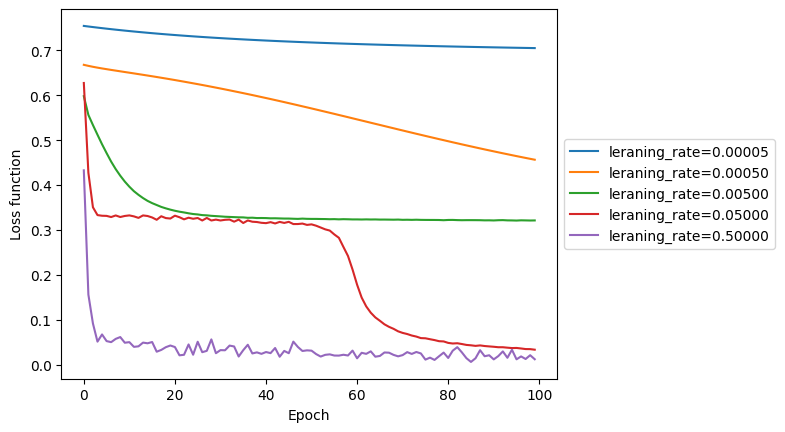

In [33]:
learning_rates = [0.5, 0.05, 0.005, 0.0005, 0.00005]
n_epochs = 100
batch_size = 16

losses = {}

# Train a model with each learning rate and populate losses with the learning rate as key and the loss series as values
for lr in learning_rates:
    params = init_mlp(2, 2, 1)
    loss_curve = train_model(params, train, eta=lr, n_epochs=n_epochs, batch_size=batch_size, print_score = False)
    losses[lr] = loss_curve


plt.figure()
for lr, loss_curve in sorted(losses.items()):
    plt.plot(loss_curve, label=f'leraning_rate={lr:.5f}')

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.ylabel('Loss function')
plt.xlabel('Epoch')

**Effect of batch size**

We will now run our training with different batch sizes to see its effect on the cost function.


Display the cost function evaluated on all training data at each epoch for batch sizes `[n_data, 100, 50, 10, 5, 1]`


Text(0.5, 0, 'Epoch')

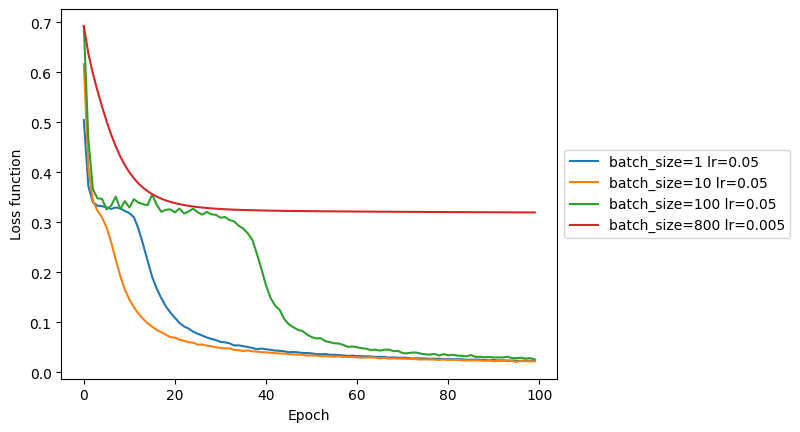

In [34]:
n_data = train.shape[0]

n_epochs = 100
batch_sizes = [n_data, 100, 10, 1]
lrs = [0.005, 0.05, 0.05, 0.05]

losses = {}

for bs, lr in zip(batch_sizes, lrs):
    params = init_mlp(2, 2, 1)
    loss_curve = train_model(params, train, eta=lr, n_epochs=n_epochs, batch_size=bs, print_score = False)
    losses[(bs, lr)] = loss_curve

# Visualize the results
plt.figure()
for (bs, lr), loss_curve in sorted(losses.items()):
    plt.plot(loss_curve, label=f'batch_size={bs} lr={lr}')

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.ylabel('Loss function')
plt.xlabel('Epoch')

**Visualization of the performance**

Another value worth monitoring is the classification accuracy of the model.


Visualize the accuracy on the train, valid and test data on each epoch

In [35]:

def train_model_2(params, data, eta, batch_size):
    n_data = data.shape[0]
    n_iterations = n_data // batch_size

    # Randomly reorder the train data
    perm_idx = torch.randperm(n_data)
    data_permuted = data[perm_idx]

    for iteration in range(n_iterations):
        # Select a block of batch_size examples
        batch_data = data_permuted[iteration*batch_size:(iteration+1)*batch_size]

        # Zero the gradients
        with torch.no_grad():
            for param in params:
                if param.grad is not None:
                    param.grad.zero_()


        x = torch.tensor(batch_data[:, :2], dtype=torch.float32)
        reference = torch.tensor(batch_data[:, 2], dtype=torch.float32)

        y_estime= mlp(x, params)


        loss = bce(y_estime, reference)

        # Compute the gradients
        loss.backward()

        # Update the parameters using gradient descent
        with torch.no_grad():
            for param in params:
                param -= eta*param.grad


Text(0.5, 0, 'Epoch')

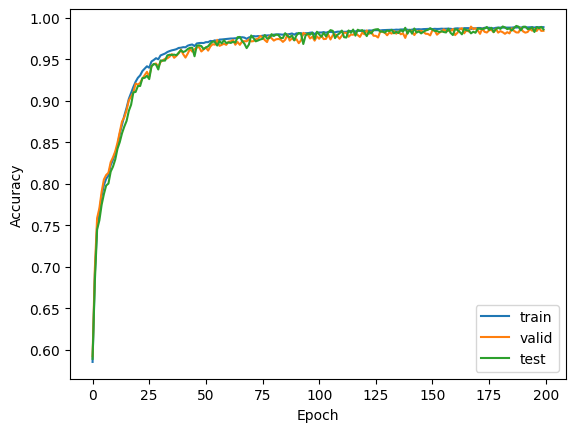

In [36]:
n_epochs = 200
batch_size = 16
learning_rate_value = 0.05

accuracies = {}

accuracies['train'] = []
accuracies['valid'] = []
accuracies['test'] = []

params = init_mlp(2, 2, 1)
for epoch in range(n_epochs):
    # Train the model
    train_model_2(params, train, eta=learning_rate_value, batch_size=batch_size)

    # Calculate accuracy on train, valid, and test data
    acc_train = score_model(params, train).item()
    acc_valid = score_model(params, valid).item()
    acc_test = score_model(params, test).item()

    # Append the accuracies to the dictionary
    accuracies['train'].append(acc_train)
    accuracies['valid'].append(acc_valid)
    accuracies['test'].append(acc_test)

plt.figure()
for split, v in accuracies.items():
    plt.plot(v, label=split)

plt.legend(loc='best')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')

**Visualization of the model parameters**

For pedagogical reasons we will now visualize the parameters of the model with its geometrical interpretation.
We will represent the parameters of the first layer of the MLP as a line (the decision boundary).

In [ ]:
pip install librosa

In [118]:
#@title
def plot_decision_boundaries(w, b, ax=None, **kwargs):
    ax = ax or plt.gca()
    x0, x1 = ax.get_xlim()
    y0, y1 = ax.get_ylim()

    arts = []
    for i in range(w.shape[1]):
        w_i = w[:, i]
        if len(b.shape)==1:
            b_i = b[i]
        else:
            b_i = b[:, i]

        intersections = []

        if w_i[1] != 0:
            yx0 = -w_i[0]/w_i[1] * x0 - b_i/w_i[1]
            yx1 = -w_i[0]/w_i[1] * x1 - b_i/w_i[1]

            if y0 <= yx0 <= y1:
                intersections.append((x0, yx0))

            if y0 <= yx1 <= y1:
                intersections.append((x1, yx1))

        if w_i[0] != 0:
            xy0 = -w_i[1]/w_i[0] * y0 - b_i/w_i[0]
            xy1 = -w_i[1]/w_i[0] * y1 - b_i/w_i[0]

            if x0 <= xy0 <= x1:
                intersections.append((xy0, y0))

            if x0 <= xy1 <= x1:
                intersections.append((xy1, y1))

        if len(intersections) == 2:
            xs, ys = zip(*intersections)
            lines, = ax.plot(xs, ys, **kwargs)

            arts.append(lines)

    ax.set_xlim([x0, x1])
    ax.set_ylim([y0, y1])

    return arts

def plot_model_and_data(params, dat=None, sel=None, ax=None):
    w, b, _, _ = params
    ax = ax or plt.gca()
    ax.set_prop_cycle(None)
    prop_cycle = ax._get_patches_for_fill.prop_cycler

    import itertools
    props = list(itertools.islice(prop_cycle, 3))

    all_arts = []

    if dat is not None:
        arts = ax.scatter(dat[dat[:,-1]==1,0], dat[dat[:,-1]==1,1],
                            facecolors='none', edgecolors=props[0]['color'], alpha=0.2)
        all_arts.append(arts)

        arts = ax.scatter(dat[dat[:,-1]==0,0], dat[dat[:,-1]==0,1],
                            facecolors='none', edgecolors=props[1]['color'], alpha=0.2)
        all_arts.append(arts)

    if sel is not None:
        arts = ax.scatter(sel[sel[:,-1]==1,0], sel[sel[:,-1]==1,1],
                            facecolors=props[0]['color'], edgecolors=props[0]['color'])
        all_arts.append(arts)

        arts = ax.scatter(sel[sel[:,-1]==0,0], sel[sel[:,-1]==0,1],
                            facecolors=props[1]['color'], edgecolors=props[1]['color'])
        all_arts.append(arts)

    line_arts = plot_decision_boundaries(w.detach().numpy(), b.detach().numpy(),
                             ax=ax,
                             color=props[2]['color'],
                             linewidth=2.0)
    all_arts += line_arts

    return all_arts

You can use the two functions created above to visualize a learning animation. You simply get the value returned by the function `plot_model_and_data(params, sel=train, ax=ax)` after each epoch.

```
art = plot_model_and_data(params, sel=train, ax=ax)
arts.append(art)
```



### Exercise 20
Visualise the decision boundaries during a training procedure.

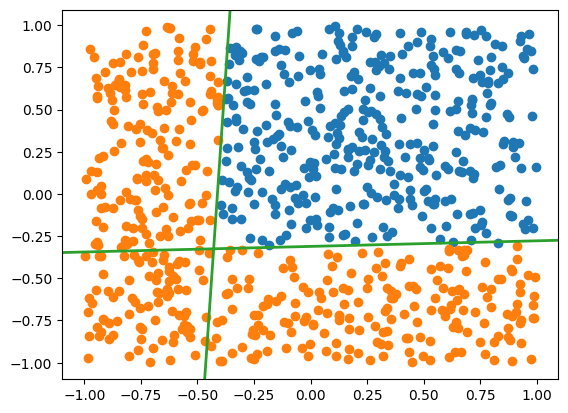

In [121]:
#@title
n_data = train.shape[0]

n_epochs = 200
batch_size = 16
learning_rate_value = 0.05

arts = []
fig, ax = plt.subplots()

### BEGIN SOLUTION
params = init_mlp(2, 2, 1)
for epoch in range(n_epochs):
    # Train the model
    train_model_2(params, train, eta=learning_rate_value, batch_size=batch_size)

    # Visualize the decision boundaries
    art = plot_model_and_data(params, sel=train, ax=ax)
    arts.append(art)


### END SOLUTION

anim = animation.ArtistAnimation(fig, arts, interval=50, repeat_delay=3000, blit=True)
HTML(anim.to_jshtml())

## Further exploration

Create a new dataset as the one depicted below.

It is similar to the first one we created, but for which we require more hidden units to classify correctly.

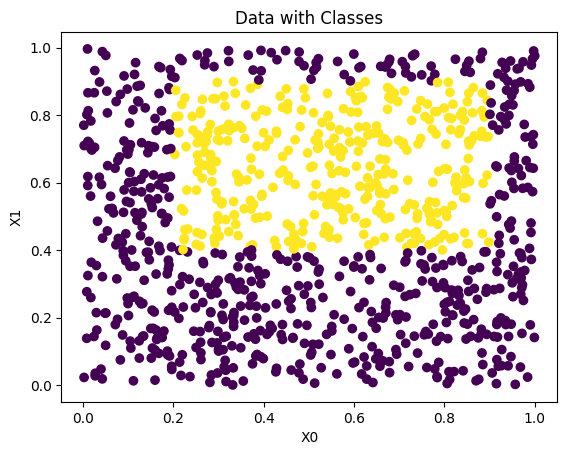

In [37]:
points = np.random.uniform(0, 1, size=(1000, 2))
y = np.where((points[:, 0] > 0.2) & (points[:, 1] > 0.4) &( points[:, 1] < 0.9 ) & ( points[:, 0] < 0.9 ), 1, 0)
data = np.column_stack((points, y))

plt.scatter(data[:,0],data[:,1], c = y)
plt.title('Data with Classes')
plt.xlabel('X0')
plt.ylabel('X1')
plt.show()


train = data[:800]
test = data[800:900]
valid = data[900:]


In [ ]:
n_epochs = 250
batch_size = 16
learning_rate_value = 0.05

for n_hidden_units in range(2, 9):
    arts = []
    fig, ax = plt.subplots()

    # Initialize model parameters for the current number of hidden units
    params = init_mlp(2, n_hidden_units, 1)

    for epoch in range(n_epochs):
        # Train the model
        train_model_2(params, train, eta=learning_rate_value, batch_size=batch_size)

        # Visualize the decision boundaries
        art = plot_model_and_data(params, sel=train, ax=ax)
        arts.append(art)

    # Display the animation for the current number of hidden units
    anim = animation.ArtistAnimation(fig, arts, interval=50, repeat_delay=3000, blit=True)
    display(HTML(anim.to_jshtml()))



<Figure size 640x480 with 0 Axes>

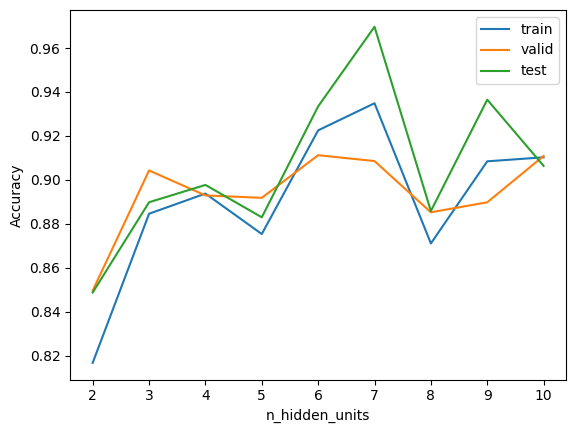

<Figure size 640x480 with 0 Axes>

In [38]:
# Create and train the model with incrementing hidden units
n_epochs = 100
batch_size = 16
learning_rate_value = 0.5

accuracies = {}

accuracies['train'] = []
accuracies['valid'] = []
accuracies['test'] = []

for n_hidden_units in range(2, 11):  # Starting from 2 hidden units up to 10
    params = init_mlp(2, n_hidden_units, 1)
    train_model(params, train, eta=learning_rate_value, n_epochs=n_epochs, batch_size=batch_size,print_score=False)

    # Calculate final accuracy
    acc_train = score_model(params, train).item()
    acc_valid = score_model(params, valid).item()
    acc_test = score_model(params, test).item()

    # Append the accuracies to the dictionary
    accuracies['train'].append(acc_train)
    accuracies['valid'].append(acc_valid)
    accuracies['test'].append(acc_test)

# Plot the final accuracy
plt.figure()
for split, v in accuracies.items():
    plt.plot(range(2, 11),v, label=split)

plt.legend(loc='best')
plt.ylabel('Accuracy')
plt.xlabel('n_hidden_units')
plt.figure()

### [Advanced]

Implement another (or all) alternative optimizers that we have seen in the lecture. Plot the loss curves of them on a same plot together with vanilla SGD.

In [39]:
# this fonction initialize m like params
def init_m(n_input, n_hidden, n_output):
    # Initialize
    m_w1 = torch.zeros(n_input, n_hidden, requires_grad=False)
    m_w2 = torch.zeros(n_hidden, n_output, requires_grad=False)

    # Initialize
    m_b1 = torch.zeros(n_hidden, requires_grad=False)
    m_b2 = torch.zeros(n_output, requires_grad=False)

    return m_w1, m_b1, m_w2, m_b2

# this fonction initialize v like params
def init_v(n_input, n_hidden, n_output):
    # Initialize
    v_w1 = torch.zeros(n_input, n_hidden, requires_grad=False)
    v_w2 = torch.zeros(n_hidden, n_output, requires_grad=False)

    # Initialize
    v_b1 = torch.zeros(n_hidden, requires_grad=False)
    v_b2 = torch.zeros(n_output, requires_grad=False)

    return v_w1, v_b1, v_w2, v_b2

In [40]:
#@title
def train_with_option_optimizer(params,m_init,v_init, data, eta=0.05, n_epochs=100, batch_size=16, optimizer = "",print_score=True):
    n_data = data.shape[0]
    n_iterations = n_data // batch_size
    losses = []

    # parameters for optimizers
    gamma  = 0.9
    eps = 1.e-8
    beta_1 = 0.9
    beta_2 = 0.199


    ### BEGIN SOLUTION
    for epoch in range(n_epochs):

        # Randomly reorder the train data
        perm_idx = torch.randperm(n_data)
        data_permuted = data[perm_idx]

        #Print the train acc every 10 epoch
        if print_score and epoch%10 == 0:
            acc_train = score_model(params, data).item()
            print(f'Epoch {epoch} \n Score: {acc_train:.2%}')

        # Init variables to keep track of the average sample loss
        avg_loss = 0.0


        for iteration in range(n_iterations):
            # Select a block of batch_size examples
            batch_data = data_permuted[iteration*batch_size:(iteration+1)*batch_size]

            # Zero the gradients
            with torch.no_grad():
                for param in params:
                    if param.grad is not None:
                        param.grad.zero_()


            x = torch.tensor(batch_data[:, :2], dtype=torch.float32)
            reference = torch.tensor(batch_data[:, 2], dtype=torch.float32)

            y_estime= mlp(x, params)


            loss = bce(y_estime, reference)
            # loss =  torch.mean(-reference*torch.log(y_estime) - (1-reference)*torch.log(1-y_estime))


            # Update variables to keep track of the average sample loss
            avg_loss += loss.item() / n_iterations

            # Compute the gradients
            loss.backward()
            # Update the parameters using different optimizer
            with torch.no_grad():
                for param,m,v in zip(params,m_init,v_init):
                    if optimizer == "SGD with momentum":
                        m = gamma * m + eta * param.grad
                        param -= m
                    elif optimizer == "NAG":  # Nesterov accelerated gradient
                        m = gamma*m + eta * (param.grad - gamma*m)
                        param -= m

                    elif optimizer == "AdaGrad":
                        v += torch.pow(param.grad,2)
                        param -= (eta * param.grad) / (torch.sqrt(v) + eps)

                    elif optimizer == "Adam":
                        m = beta_1 * m + (1 - beta_1) * param.grad
                        v = beta_2 * v + (1 - beta_2) * torch.pow(param.grad, 2)

                        m_ = m / (1 - beta_1 ** (iteration + 1))  # Adjust iteration count
                        v_ = v / (1 - beta_2 ** (iteration + 1))

                        param -= (eta * m_) / (torch.sqrt(v_) + eps)

                    else:
                        # Default to vanilla SGD if optimizer is not recognized
                        param -= eta * param.grad

        # Collect average sample loss of the
        losses.append(avg_loss)
    return losses

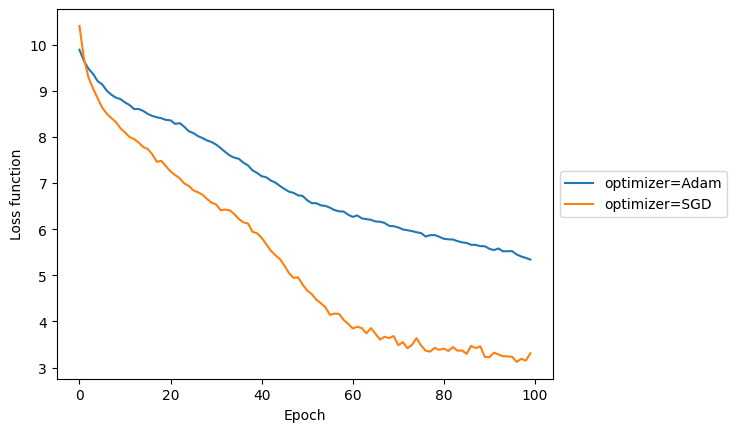

In [41]:
#@title
# optimizers = ["SGD","SGD with momentum","NAG","AdaGrad", "Adam"]
optimizers = ["SGD","Adam"]
n_epochs = 100
batch_size = 16
n_hidden_units = 5
losses = {}

# Train a model with each learning rate and populate losses with the learning rate as key and the loss series as values
### BEGIN SOLUTION
for optimizer in optimizers:
    m_init = init_m(2, n_hidden_units, 1)
    v_init = init_m(2, n_hidden_units, 1)
    params = init_mlp(2, n_hidden_units, 1)
    loss_curve = train_with_option_optimizer(params, m_init, v_init, train, eta=0.05, n_epochs=100,batch_size=16, optimizer=optimizer, print_score=False)
    losses[optimizer] = loss_curve

### END SOLUTION

plt.figure()
for optimizer, loss_curve in sorted(losses.items()):
    plt.plot(loss_curve, label=f'optimizer={optimizer}')

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.ylabel('Loss function')
plt.xlabel('Epoch')
plt.show()



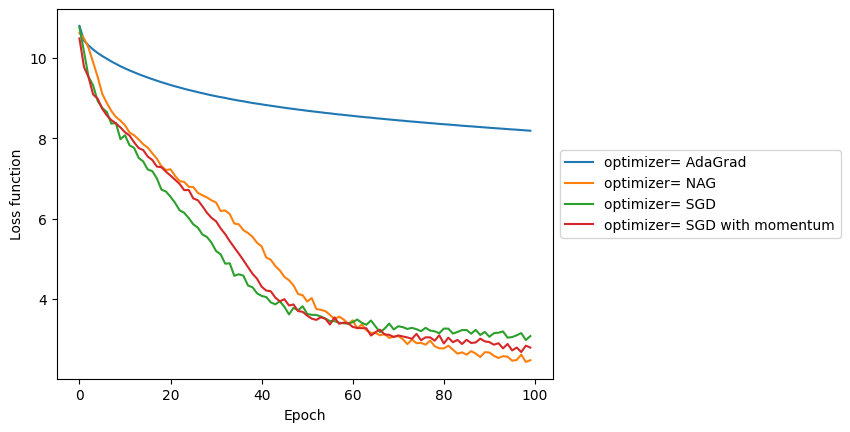

In [42]:
#@title
optimizers = ["SGD","NAG","SGD with momentum","AdaGrad"]
n_epochs = 100
batch_size = 16

losses = {}

# Train a model with each learning rate and populate losses with the learning rate as key and the loss series as values
### BEGIN SOLUTION
for optimizer in optimizers:
    m_init = init_m(2, n_hidden_units, 1)
    v_init = init_v(2, n_hidden_units, 1)
    params = init_mlp(2, n_hidden_units, 1)
    loss_curve = train_with_option_optimizer(params, m_init, v_init, train, eta=0.05, n_epochs=100,batch_size=16, optimizer=optimizer, print_score=False)
    losses[optimizer] = loss_curve

### END SOLUTION

plt.figure()
for optimizer, loss_curve in sorted(losses.items()):
    plt.plot(loss_curve, label=f'optimizer= {optimizer}')


plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.ylabel('Loss function')
plt.xlabel('Epoch')
plt.show()

